In [2]:
import numpy as np
import cupy as cp
import cupyx.scipy.signal as signal
import scipy
import pandas as pd

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots

from astropy.modeling import models, fitting
import astropy.units as u
from astropy import constants as const
from astropy.stats import gaussian_sigma_to_fwhm

import datetime
import pickle
import importlib
import json
import time
import glob

from eve_part.data.constant import wavelength_list_eve
from eve_part.gaussian_fit_eve import gaussian_fit_eve

In [2]:
eve_files=sorted(glob.glob('eve_part/data/EVE_sav/EVS_L2*.sav'))
eve_data=[]
for eve_file in eve_files:
    eve_data.append( scipy.io.readsav(eve_file) )

In [ ]:
len(eve_files)/24

1504.25

In [5]:
eve_files=sorted(glob.glob('eve_part/data/EVE_sav/EVS_L2*.sav'))
data=scipy.io.readsav(eve_files[0])

In [6]:
data

{'wavelength': array([  3.01,   3.03,   3.05, ..., 106.95, 106.97, 106.99], dtype='>f4'),
 'sod_time': array([2.65536070e-01, 1.02655361e+01, 2.02655361e+01, 3.02655361e+01,
        4.02655361e+01, 5.02655361e+01, 6.02655361e+01, 7.02655361e+01,
        8.02655361e+01, 9.02655361e+01, 1.00265536e+02, 1.10265536e+02,
        1.20265536e+02, 1.30265536e+02, 1.40265536e+02, 1.50265536e+02,
        1.60265536e+02, 1.70265536e+02, 1.80265536e+02, 1.90265536e+02,
        2.00265536e+02, 2.10265536e+02, 2.20265536e+02, 2.30265536e+02,
        2.40265536e+02, 2.50265536e+02, 2.60265536e+02, 2.70265536e+02,
        2.80265536e+02, 2.90265536e+02, 3.00265536e+02, 3.10265536e+02,
        3.20265536e+02, 3.30265536e+02, 3.40265536e+02, 3.50265536e+02,
        3.60265536e+02, 3.70265536e+02, 3.80265536e+02, 3.90265536e+02,
        4.00265536e+02, 4.10265536e+02, 4.20265536e+02, 4.30265536e+02,
        4.40265536e+02, 4.50265536e+02, 4.60265536e+02, 4.70265536e+02,
        4.80265536e+02, 4.90265536

## sav files

In [3]:
eve_data[0].keys()

dict_keys(['wavelength', 'sod_time', 'irradiance', 'sc_flags', 'flags', 'yyyydoy'])

In [11]:
eve_data[0]['yyyydoy']

array([2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010120, 2010120, 2010120, 2010120, 2010120, 2010120,
       2010120, 2010

In [9]:
eve_data[0]['sod_time']

array([2.65536070e-01, 1.02655361e+01, 2.02655361e+01, 3.02655361e+01,
       4.02655361e+01, 5.02655361e+01, 6.02655361e+01, 7.02655361e+01,
       8.02655361e+01, 9.02655361e+01, 1.00265536e+02, 1.10265536e+02,
       1.20265536e+02, 1.30265536e+02, 1.40265536e+02, 1.50265536e+02,
       1.60265536e+02, 1.70265536e+02, 1.80265536e+02, 1.90265536e+02,
       2.00265536e+02, 2.10265536e+02, 2.20265536e+02, 2.30265536e+02,
       2.40265536e+02, 2.50265536e+02, 2.60265536e+02, 2.70265536e+02,
       2.80265536e+02, 2.90265536e+02, 3.00265536e+02, 3.10265536e+02,
       3.20265536e+02, 3.30265536e+02, 3.40265536e+02, 3.50265536e+02,
       3.60265536e+02, 3.70265536e+02, 3.80265536e+02, 3.90265536e+02,
       4.00265536e+02, 4.10265536e+02, 4.20265536e+02, 4.30265536e+02,
       4.40265536e+02, 4.50265536e+02, 4.60265536e+02, 4.70265536e+02,
       4.80265536e+02, 4.90265536e+02, 5.00265536e+02, 5.10265536e+02,
       5.20265536e+02, 5.30265536e+02, 5.40265536e+02, 5.50265536e+02,
      

In [4]:
eve_data[0]['irradiance'].shape

(360, 12)

In [5]:
eve_data[0]['irradiance']

array([[2.6092563e-05, 1.3120413e-04, 4.6210643e-04, ..., 1.9184785e-04,
        7.4447729e-05, 5.0256080e-05],
       [2.4313835e-05, 1.2673343e-04, 4.5906374e-04, ..., 1.9270962e-04,
        7.4217343e-05, 5.2136638e-05],
       [2.5151077e-05, 1.2693906e-04, 4.5360095e-04, ..., 1.9306244e-04,
        7.5396048e-05, 4.9857281e-05],
       ...,
       [2.4454952e-05, 1.2538122e-04, 4.4970470e-04, ..., 1.9645243e-04,
        7.4025680e-05, 4.9669805e-05],
       [2.3844912e-05, 1.2517138e-04, 4.4692168e-04, ..., 1.9064517e-04,
        7.5509692e-05, 4.8641719e-05],
       [2.4004403e-05, 1.2427327e-04, 4.5152172e-04, ..., 1.9405322e-04,
        7.5528958e-05, 4.9332873e-05]], dtype=float32)

In [6]:
eve_data[0]['wavelength'][1363:1375].shape

(12,)

In [7]:
eve_data[0]['wavelength'][1363:1375]

array([30.27, 30.29, 30.31, 30.33, 30.35, 30.37, 30.39, 30.41, 30.43,
       30.45, 30.47, 30.49], dtype=float32)

In [8]:
len(eve_data[0]['yyyydoy'])

360

## reorganize data
time   irradiance

In [24]:
time_converter('2011268',sod_time)

datetime.datetime(2011, 9, 25, 22, 59, 59)

In [9]:
sod_time

82799.59866642952

In [12]:
sod_time=int()

82799.59866642952

In [3]:
def time_converter(yyyydoy,sod_time):
    '''
    yyyydoy: int
    sod_time: float
    '''
    year = int(str(yyyydoy)[:4])
    day_of_year = int(str(yyyydoy)[4:])
    delta = datetime.timedelta(days=day_of_year - 1)
    date = datetime.datetime(year, 1, 1) + delta
    
    sod_time=int(sod_time)
    date += datetime.timedelta(seconds=sod_time)
    return date

In [4]:
time_list=[]
irradiance_list=[]
for i in range(len(eve_data)):
    for j in range(len(eve_data[i]['yyyydoy'])):
        # time
        yyyydoy=str(eve_data[i]['yyyydoy'][j])
        sod_time=eve_data[i]['sod_time'][j]
        # anomaly
        flag=np.where(eve_data[i]['sc_flags'][j] == 0, 1, np.nan)*\
                np.where((eve_data[i]['flags'][j] == 16) | 
                         (eve_data[i]['flags'][j] == 1), np.nan, 1)
        # irrdiance around He II
        irradiance=eve_data[i]['irradiance'][j]
        
        time_list.append(time_converter(yyyydoy,sod_time))
        irradiance_list.append(flag*irradiance)

### df 10s 

In [5]:
original_data={
                'time':time_list,
                'irradiance':irradiance_list,
                }
original_df=pd.DataFrame(original_data)
original_df=original_df.set_index('time')

In [ ]:
time_list1 = original_df.index.tolist()
irradiance_list1 = original_df['irradiance'].tolist()

In [18]:
original_df.loc[datetime.datetime(2010, 4, 30, 0, 0, 0)]

irradiance    [2.6092563e-05, 0.00013120413, 0.00046210643, ...
Name: 2010-04-30 00:00:00, dtype: object

In [19]:
original_df.iloc[0]

irradiance    [2.6092563e-05, 0.00013120413, 0.00046210643, ...
Name: 2010-04-30 00:00:00, dtype: object

In [20]:
original_df.loc[datetime.datetime(2010, 9, 16, 0, 0, 0),'irradiance']

array([3.1856129e-05, 1.5028619e-04, 4.9046811e-04, 1.8906939e-03,
       4.2626890e-03, 6.0453378e-03, 5.2698432e-03, 2.8225072e-03,
       9.2825689e-04, 1.9959750e-04, 7.4325813e-05, 5.2640149e-05],
      dtype=float32)

#### 3d 

In [12]:
def irradiance_plotly_3d(start_time,end_time,datetime_list):
    '''
    3d scatter
    '''
    # Filter the datetime list based on the time range
    selected_datetimes =[dt for dt in datetime_list 
                         if start_time <= dt <= end_time]
    selected_data=[]
    for key in selected_datetimes:
        selected_data.append(original_df.loc[key,'irradiance'])
        
        
    selected_data=np.array(selected_data)
    
    # selected_data=np.reshape(selected_data,
    #                       (selected_data.shape[0]*selected_data.shape[1],selected_data.shape[2]))
    selected_data=np.where(selected_data>0, selected_data, np.nan)
    

    # Generate x and y coordinates for the surface plot
    x = np.arange(selected_data.shape[1])
    y = np.arange(selected_data.shape[0])
    X, Y = np.meshgrid(x, y)

    # Create the surface plot
    # fig = go.Figure(data=[go.Surface(x=X, y=Y, z=selected_data)])
    fig = go.Figure(data=[go.Scatter3d(
        x=X.flatten(), 
        y=Y.flatten(), 
        z=selected_data.flatten(),
        mode='markers'
    )
                         ])

    # Customize the layout
    fig.update_layout(
        title='3D Surface Plot',
        scene=dict(
            xaxis=dict(
                title='wavelength (nm)',
                ticktext=wavelength_list_eve,  # Set the desired tick labels
                tickvals=x,  # Use the x coordinates as tick values
            ),
            yaxis=dict(title='Time (10s)'),
            zaxis=dict(title='Irradiance')
        )
    )
    fig.show()

In [18]:
def irradiance_plotly_3d(start_time,end_time,original_df):
    '''
    3d surface
    '''
    #time range
    selected_df = original_df.loc[start_time:end_time]
    #omit invalid data
    irradiance=np.array(selected_df['irradiance'].to_list())
    irradiance=np.where(irradiance>0., irradiance, np.nan)
    selected_time_list=selected_df.index.to_list()
    # Generate x and y coordinates for the surface plot
    x = np.arange(np.shape(irradiance)[1])
    y = np.arange(np.shape(irradiance)[0])
    X, Y = np.meshgrid(x, y)

    # Create the surface plot
    fig = go.Figure(data=[go.Surface(x=X,y=Y,z=irradiance )])
    
    # Customize the layout
    fig.update_layout(
        title='3D Surface Plot',
        # width=550, 
        height=700,
        scene=dict(
            xaxis=dict(
                title='wavelength (nm)',
                ticktext=wavelength_list_eve[::2],  # Set the desired tick labels
                tickvals=x[::2],  # Use the x coordinates as tick values
            ),
            yaxis=dict(title='Time (10s)',
                       ticktext=selected_time_list[::len(selected_time_list)//5],
                      tickvals=y[::len(y)//5]),
            zaxis=dict(title='Irradiance')
        ),
        # margin=dict(l=0,r=20)
    )
    fig.show()
    fig.write_html('eve_part/days_3d.html')

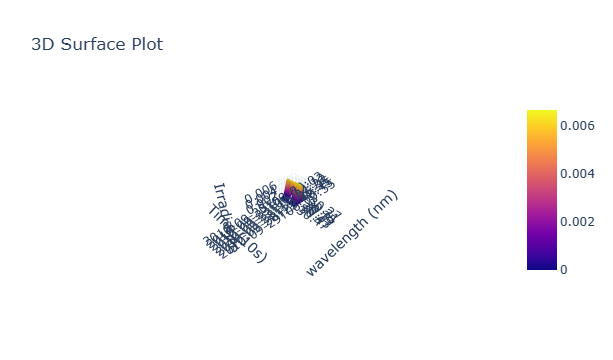

In [19]:
start_time=datetime.datetime(2010, 9, 23, 0, 0,0)
end_time=datetime.datetime(2010, 9, 29, 6, 1,30)
# original_df.index
irradiance_plotly_3d(start_time,end_time,original_df)

In [18]:
datetime.datetime.strftime(new_df.index.to_list()[0],"%Y-%M-%d")

NameError: name 'new_df' is not defined

#### pickle

In [10]:
original_df

,irradiance
time,
2010-04-30 00:00:00,"[2.6092563e-05, 0.00013120413, 0.00046210643, ..."
2010-04-30 00:00:10,"[2.4313835e-05, 0.00012673343, 0.00045906374, ..."
2010-04-30 00:00:20,"[2.5151077e-05, 0.00012693906, 0.00045360095, ..."
2010-04-30 00:00:30,"[2.5799252e-05, 0.00012680102, 0.0004512957, 0..."
2010-04-30 00:00:40,"[2.7351613e-05, 0.00012936983, 0.0004534847, 0..."
...,...
2014-12-31 22:59:19,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."
2014-12-31 22:59:29,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."
2014-12-31 22:59:39,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."


In [9]:
# Load the DataFrame from the binary file
with open('eve_part/data/original_data.pkl', 'rb') as file:
    original_df = pickle.load(file)

#### save & read

        time    array
        
pickle  yes     yes

npz     no      yes

csv     yes     no

In [111]:
start_date = '2014-06-01'
end_date = '2014-06-02'

new_df = original_df.loc[start_date:end_date]

In [122]:
new_df.irradiance.values.shape

(2520,)

In [12]:
original_df

,irradiance
time,
2010-04-30 00:00:00,"[2.6092563e-05, 0.00013120413, 0.00046210643, ..."
2010-04-30 00:00:10,"[2.4313835e-05, 0.00012673343, 0.00045906374, ..."
2010-04-30 00:00:20,"[2.5151077e-05, 0.00012693906, 0.00045360095, ..."
2010-04-30 00:00:30,"[2.5799252e-05, 0.00012680102, 0.0004512957, 0..."
2010-04-30 00:00:40,"[2.7351613e-05, 0.00012936983, 0.0004534847, 0..."
...,...
2014-12-31 22:59:19,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."
2014-12-31 22:59:29,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."
2014-12-31 22:59:39,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."


In [7]:
with open('eve_part/data/original_data.pkl', 'wb') as file:
    pickle.dump(original_df, file)

In [2]:
with open('eve_part/data/original_data.pkl', 'rb') as file:
    original_df = pickle.load(file)

In [4]:
original_df

,irradiance
time,
2010-04-30 00:00:00,"[2.6092563e-05, 0.00013120413, 0.00046210643, ..."
2010-04-30 00:00:10,"[2.4313835e-05, 0.00012673343, 0.00045906374, ..."
2010-04-30 00:00:20,"[2.5151077e-05, 0.00012693906, 0.00045360095, ..."
2010-04-30 00:00:30,"[2.5799252e-05, 0.00012680102, 0.0004512957, 0..."
2010-04-30 00:00:40,"[2.7351613e-05, 0.00012936983, 0.0004534847, 0..."
...,...
2014-12-31 22:59:19,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."
2014-12-31 22:59:29,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."
2014-12-31 22:59:39,"[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1...."


### df day

In [45]:
def f(x):
    return list(x)
daily_df = original_df.resample('D')
daily_df =daily_df['irradiance'].agg(f)
daily_df=daily_df.to_frame()
daily_df

,irradiance
time,
2010-04-30,"[[2.6092563e-05, 0.00013120413, 0.00046210643,..."
2010-05-01,"[[2.6801172e-05, 0.00012922639, 0.00046054466,..."
2010-05-02,"[[2.634514e-05, 0.0001303286, 0.00045836368, 0..."
2010-05-03,"[[2.6261685e-05, 0.00012864708, 0.00045742025,..."
2010-05-04,"[[2.841554e-05, 0.00013703041, 0.00046953457, ..."
...,...
2014-12-27,"[[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1..."
2014-12-28,"[[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1..."
2014-12-29,"[[-1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1.0, -1..."


Certainly! Let's break down your previous code step by step:

def f(x): return list(x): This is a function definition where f is a function that takes an argument x and returns a list representation of x. Essentially, it converts the input x (in this case, a Pandas Series) into a Python list.

daily_df = original_df.resample('D'): This line performs resampling on the original_df DataFrame, grouping the data based on a daily frequency ('D'). The result is a resampled DataFrame object, daily_df, which contains the groups of data for each day.

daily_df['irradiance'].agg(f): Here, you are accessing the 'irradiance' column of the daily_df DataFrame using daily_df['irradiance']. Then, you apply the agg() function to that column.

agg(f): The agg() function is used to apply the function f (defined earlier) to each group of values within the 'irradiance' column. For each group, the function f converts the group (a Pandas Series) into a Python list using list(x). The result is a new Pandas Series where each value represents a list of the values from each group.

daily_df: Finally, the result of the agg() operation is assigned back to daily_df, effectively replacing the 'irradiance' column with the new Pandas Series where each value represents a list of values from each group.

So, in summary, your code performs resampling on the original_df DataFrame at a daily frequency. Then, it applies the agg() function to the 'irradiance' column, using the f function to convert each group of values into a Python list. The resulting DataFrame, daily_df, contains the 'irradiance' column, where each value represents a list of values from each day's group.

In [193]:
daily_df.index

DatetimeIndex(['2010-04-30', '2010-05-01', '2010-05-02', '2010-05-03',
               '2010-05-04', '2010-05-05', '2010-05-06', '2010-05-07',
               '2010-05-08', '2010-05-09',
               ...
               '2014-12-22', '2014-12-23', '2014-12-24', '2014-12-25',
               '2014-12-26', '2014-12-27', '2014-12-28', '2014-12-29',
               '2014-12-30', '2014-12-31'],
              dtype='datetime64[ns]', name='time', length=1707, freq='D')

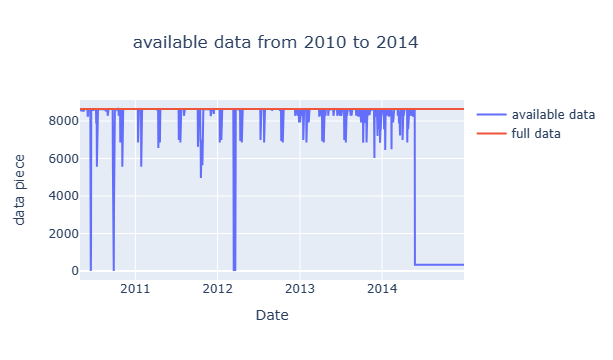

In [46]:
error_num=[]
for key in daily_df.index:
    error_num.append((np.size(daily_df.loc[key]['irradiance'])
                     -np.sum(np.isnan(daily_df.loc[key]['irradiance'])))/12
                    )
    
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots

In [47]:
year_data=daily_df['irradiance'].values
np.shape(year_data)

(1707,)

In [49]:
years_data=[]
for data in year_data:
    years_data.extend(data)
years_data=np.array(years_data)
years_data=np.where(years_data>0,years_data,np.nan)

C:\Users\14902\AppData\Local\Temp\ipykernel_22548\1070997745.py:5: UserWarning:

FixedFormatter should only be used together with FixedLocator



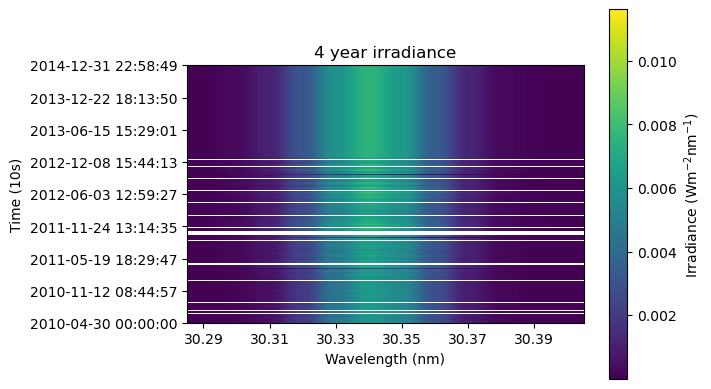

In [94]:
fig,ax=plt.subplots()
sc=ax.imshow(years_data,aspect=6e-7,origin='lower')
ax.set_ylabel('Time (10s)')
ax.set_xlabel('Wavelength (nm)')
ax.set_xticklabels(wavelength_list_eve)

ax.set_yticks(np.linspace(0,len(years_data),9))
ax.set_yticklabels(time_list[::len(time_list)//8-1])

cbar = plt.colorbar(sc)
cbar.set_label(r'Irradiance ($\rm{W m^{-2} nm^{-1})}$')
ax.set_title('4 year irradiance');

In [19]:
#尝试画出等值线但是失败了
temp=years_data[3000_000:3100_000,:]
# Generate x and y coordinates for the surface plot
x = np.arange(temp.shape[1])
y = np.arange(temp.shape[0])
X, Y = np.meshgrid(x, y)

# Create the surface plot
fig = go.Figure(data=[go.Surface(x=X, y=Y, z=temp)])

# Customize the layout
fig.update_layout(
    title='3D Surface Plot',
    scene=dict(
        xaxis=dict(
            title='wavelength (nm)',
            ticktext=wavelength_list_eve,  # Set the desired tick labels
            tickvals=x,  # Use the x coordinates as tick values
        ),
        yaxis=dict(title='Time (10s)'),
        zaxis=dict(title='Irradiance')
    )
)
fig.write_html('sample_year_3d.html')
fig.show()

NameError: name 'years_data' is not defined

## fit 10s

In [103]:
start=time.time()
cen_10s_list=[]
stddev_10s_list=[]
amp_10s_list=[]
i=0
for key in original_df.index:
    amp,cen,stddev=eve_part.gaussian_fit_eve.gaussian_fit_eve(wavelength_list_eve,original_df.loc[key]['irradiance'])
    amp_10s_list.append(amp)
    stddev_10s_list.append(stddev)
    cen_10s_list.append(cen)
    # if not np.isnan(cen):
    # print(key,cen)
    i=i+1
    if(i%8640==0):
        print(key,cen)

# save file hell
np.savez('eve_part/data/fit_10s.npz',
        cen_10s_list=cen_10s_list,
         stddev_10s_list=stddev_10s_list,
         amp_10s_list=amp_10s_list
        )

end=time.time()
end-start

2010-04-30 23:59:50.473855 30.374103006919857
2010-05-01 23:59:50.694140 30.37411004850087
2010-05-02 23:59:50.912718 30.374022449534127
2010-05-03 23:59:51.129421 30.37380511654943
2010-05-04 23:59:51.347956 30.373875501650755
2010-05-05 23:59:51.587378 30.37405190963667
2010-05-06 23:59:51.804901 30.374185439295807
2010-05-07 23:59:52.022096 30.373982563964077
2010-05-08 23:59:52.237832 30.37397943568474
2010-05-09 23:59:52.454245 30.374267882596957
2010-05-10 23:59:52.684050 30.374187794762467
2010-05-11 23:59:52.260650 30.37461547850764
2010-05-12 23:59:52.464456 30.3744116446295
2010-05-13 23:59:52.668513 30.372075613427356
2010-05-14 23:59:52.903273 30.374680278288288
2010-05-15 23:59:53.129373 30.374619110257996
2010-05-16 23:59:53.360597 30.37458993163416
2010-05-17 23:59:53.579791 30.37456252450221
2010-05-18 23:59:53.802612 30.372858481716573
2010-05-19 23:59:54.039664 30.372660784170993
2010-05-20 23:59:54.272178 30.372386113745673
2010-05-21 23:59:54.506399 30.3725895632772

C:\Users\14902\anaconda3\envs\sdo2022\lib\site-packages\scipy\optimize\_minpack_py.py:486: RuntimeWarning: overflow encountered in matmul
  cov_x = invR @ invR.T


2010-09-16 00:59:50.853760 30.374218185708195
2010-09-17 00:59:51.141262 30.374328358008476
2010-09-18 00:59:51.433999 30.374425745742414
2010-09-19 00:59:51.729652 30.374383911105937
2010-09-20 00:59:52.015619 30.37450520178672
2010-09-21 00:59:52.282524 30.3746533020636
2010-09-22 00:59:52.560072 30.374824300513882
2010-09-23 00:59:52.811575 30.37509013103738
2010-09-28 23:59:55.147268 30.374641712460317
2010-09-29 23:59:55.414196 30.37480154571949
2010-09-30 23:59:55.693817 30.374835435650358
2010-10-01 23:59:55.958730 30.374963947804936
2010-10-02 23:59:56.244623 30.37523187210313
2010-10-03 23:59:56.526084 30.375050300871695
2010-10-04 23:59:56.799796 30.374870697251307
2010-10-05 23:59:57.097748 30.374693250353946
2010-10-06 23:59:57.379642 30.375112048553298
2010-10-07 23:59:57.688310 30.374999911719136
2010-10-08 23:59:58.005490 30.374526060480886
2010-10-09 23:59:58.274201 30.374314384332568
2010-10-10 23:59:58.563715 30.374563236515858
2010-10-11 23:59:58.794375 30.3745578163

25054.923703193665

In [85]:
fit_10s_df={'time':time_list,
           'mean':cen_10s_list,
           'stddev':stddev_10s_list,
           'amplitude':amp_10s_list}
fit_10s_df=pd.DataFrame(fit_10s_df)
fit_10s_df=fit_10s_df.set_index('time')

In [43]:
fit_10s_df.loc[datetime.datetime(2014,12,20)]

KeyError: datetime.datetime(2014, 12, 20, 0, 0)

In [145]:
fit_10s_df

,mean,stddev,amplitude
time,,,
2010-04-30 00:00:00,30.374182,0.028687,0.006621
2010-04-30 00:00:10,30.374068,0.028704,0.006623
2010-04-30 00:00:20,30.374196,0.028695,0.006581
2010-04-30 00:00:30,30.374199,0.028807,0.006522
2010-04-30 00:00:40,30.374291,0.028811,0.006493
...,...,...,...
2014-12-31 22:59:19,NaN,NaN,NaN
2014-12-31 22:59:29,NaN,NaN,NaN
2014-12-31 22:59:39,NaN,NaN,NaN


### visualization

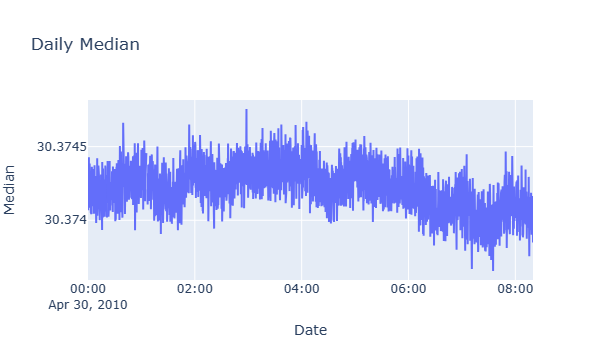

In [19]:
fig_mean = go.Figure(data=go.Scatter(x=fit_10s_df.index[:3000], y=fit_10s_df['mean'][:3000]))
fig_mean.update_layout(title="Daily Median", xaxis_title="Date", yaxis_title="Median")
fig_mean.show()

### save & read

In [26]:
fit_10s_df.to_csv('eve_part/data/fit_10s.csv')

In [27]:
fit_10s_df=pd.read_csv('eve_part/data/fit_10s.csv')
fit_10s_df=fit_10s_df.set_index('time')
fit_10s_df.index = pd.to_datetime(fit_10s_df.index)

In [29]:
with open('eve_part/data/fit_10s.pkl', 'wb') as file:
    pickle.dump(fit_10s_df, file)

In [2]:
with open('eve_part/data/fit_10s.pkl', 'rb') as file:
    fit_10s_df=pickle.load(file)

In [5]:
fit_10s_df

,mean,stddev,amplitude
time,,,
2010-04-30 00:00:00,30.374182,0.028687,0.006621
2010-04-30 00:00:10,30.374068,0.028704,0.006623
2010-04-30 00:00:20,30.374196,0.028695,0.006581
2010-04-30 00:00:30,30.374199,0.028807,0.006522
2010-04-30 00:00:40,30.374291,0.028811,0.006493
...,...,...,...
2014-12-31 22:59:19,NaN,NaN,NaN
2014-12-31 22:59:29,NaN,NaN,NaN
2014-12-31 22:59:39,NaN,NaN,NaN


## fit day

In [142]:
np.nanstd([5,1])

2.0

In [146]:
np.size([5,1])-np.sum(np.isnan([5,1]))

2

In [3]:
# COUNT availabel data
def f(x):
    y=np.size(x)-np.sum(np.isnan(x))
    return y

stddev_of_mean=fit_10s_df['mean'].resample('D').agg(np.nanstd)
stddev_of_stddev=fit_10s_df['stddev'].resample('D').agg(np.nanstd)
stddev_of_amplitude=fit_10s_df['amplitude'].resample('D').agg(np.nanstd)
available_data=fit_10s_df['amplitude'].resample('D').agg(f)

In [4]:
gaussian_sigma_to_fwhm

2.3548200450309493

In [5]:
# Resample the data to daily frequency and calculate the median
daily_median = fit_10s_df.resample('D').agg(np.nanmedian)

# Create a new DataFrame 'daily_fit_df' to store the daily median, stddev, and amplitude
# fwhm=2.3*stddev
daily_fit_df = pd.DataFrame()
daily_fit_df['median_of_mean'] = daily_median['mean']
daily_fit_df['median_of_fwhm'] = gaussian_sigma_to_fwhm*daily_median['stddev']
daily_fit_df['median_of_amplitude'] = daily_median['amplitude']

daily_fit_df['stddev_of_mean']=stddev_of_mean
daily_fit_df['stddev_of_fwhm']=gaussian_sigma_to_fwhm*stddev_of_stddev
daily_fit_df['stddev_of_amplitude']=stddev_of_amplitude
daily_fit_df['available_data']=available_data
# Print the new DataFrame
daily_fit_df

,median_of_mean,median_of_fwhm,median_of_amplitude,stddev_of_mean,stddev_of_fwhm,stddev_of_amplitude,available_data
time,,,,,,,
2010-04-30,30.374138,0.068078,0.006518,0.000175,0.000179,0.000058,8570
2010-05-01,30.374133,0.068256,0.006556,0.000199,0.000164,0.000052,8579
2010-05-02,30.374000,0.068359,0.006503,0.000210,0.000165,0.000048,8579
2010-05-03,30.373922,0.068380,0.006513,0.000206,0.000240,0.000049,8640
2010-05-04,30.373876,0.068305,0.006656,0.000195,0.000216,0.000059,8578
...,...,...,...,...,...,...,...
2014-12-27,NaN,NaN,NaN,NaN,NaN,NaN,0
2014-12-28,NaN,NaN,NaN,NaN,NaN,NaN,0
2014-12-29,NaN,NaN,NaN,NaN,NaN,NaN,0


In [42]:
daily_fit_df.index

DatetimeIndex(['2010-04-30', '2010-05-01', '2010-05-02', '2010-05-03',
               '2010-05-04', '2010-05-05', '2010-05-06', '2010-05-07',
               '2010-05-08', '2010-05-09',
               ...
               '2014-12-22', '2014-12-23', '2014-12-24', '2014-12-25',
               '2014-12-26', '2014-12-27', '2014-12-28', '2014-12-29',
               '2014-12-30', '2014-12-31'],
              dtype='datetime64[ns]', name='time', length=1707, freq='D')

In [43]:
daily_fit_df.loc[datetime.datetime(2010,9,26)]

median_of_mean        NaN
median_of_stddev      NaN
median_of_amplitude   NaN
stddev_of_mean        NaN
stddev_of_stddev      NaN
stddev_of_amplitude   NaN
Name: 2010-09-26 00:00:00, dtype: float64

In [44]:
daily_fit_df.iloc[100]#datetime.datetime(2014,12,20)

median_of_mean         30.373494
median_of_stddev        0.028737
median_of_amplitude     0.006520
stddev_of_mean          0.000316
stddev_of_stddev        0.000099
stddev_of_amplitude     0.000046
Name: 2010-08-08 00:00:00, dtype: float64

### 2d plot visual

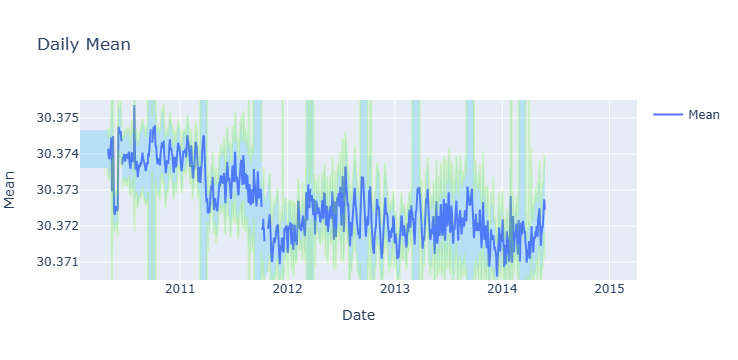

In [14]:
# Example data with nan values
x = daily_fit_df.index
y_mean = daily_fit_df['median_of_mean']
y_stddev = daily_fit_df['stddev_of_mean']

# Create the figure
fig_mean = go.Figure()

# Plot the mean line
fig_mean.add_trace(go.Scatter(x=x, y=y_mean, mode='lines', name='Mean'))

# Plot the shaded area between mean + 3 std deviations and mean - 3 std deviations
fill_x = np.concatenate([x, x[::-1]])
fill_y = np.concatenate([y_mean + 3 * y_stddev, (y_mean - 3 * y_stddev)[::-1]])

fig_mean.add_trace(go.Scatter(x=fill_x, y=fill_y, mode='lines', 
                              fill='tozerox', 
                              fillcolor='rgba(0,176,246,0.2)',
                              line=dict(color='rgba(127,255,0,0.2)'),
                              showlegend=False, name='3 Std. Dev.'))

# Set the layout
fig_mean.update_layout(title="Daily Mean", xaxis_title="Date", yaxis_title="Mean")
fig_mean.update_yaxes(range=[30.3705, 30.3755])
# Show the plot
fig_mean.show()

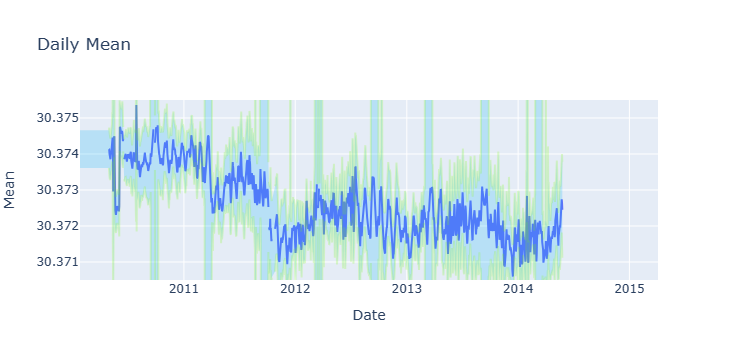

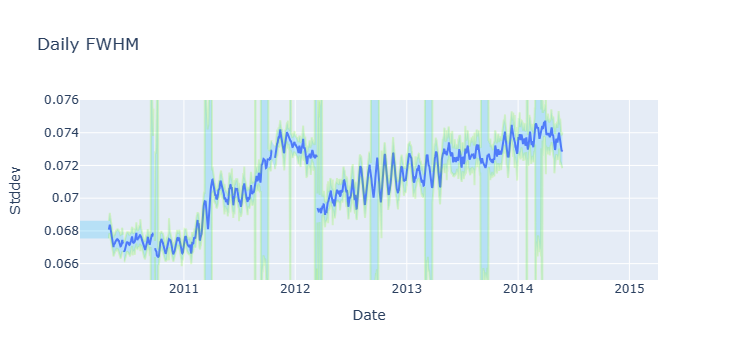

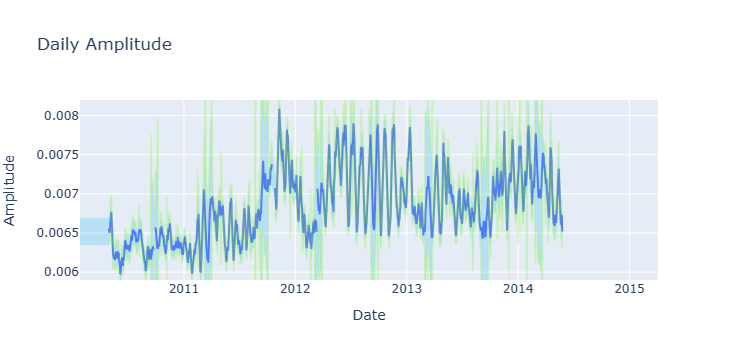

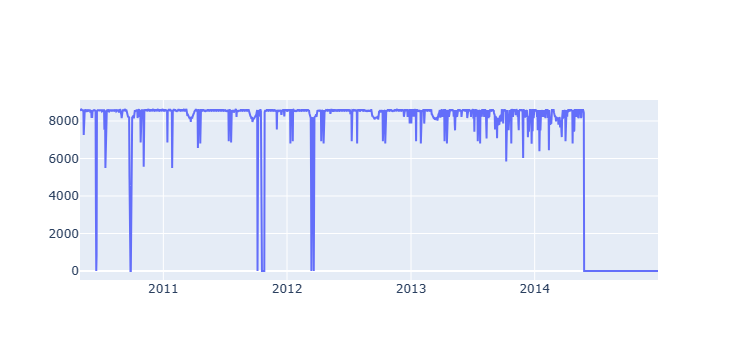

In [22]:
valid_day=np.where(daily_fit_df['available_data']>=np.nanmean(daily_fit_df['available_data'])*0.2,1,np.nan)

fig_mean = go.Figure()
x = daily_fit_df.index
y_mean = daily_fit_df['median_of_mean']*valid_day
y_stddev = daily_fit_df['stddev_of_mean']
fill_x = np.concatenate([x, x[::-1]])
fill_y = np.concatenate([y_mean + 3 * y_stddev, (y_mean - 3 * y_stddev)[::-1]])

# Plot the mean line
fig_mean.add_trace(go.Scatter(x=x, y=y_mean,
                              showlegend=False, 
                             line=dict(color='rgba(250,76,153)'), 
                   )
)
# Plot the shaded area between mean + 3 std deviations and mean - 3 std deviations


fig_mean.add_trace(go.Scatter(x=fill_x, y=fill_y, mode='lines', 
                              fill='tozerox', 
                              fillcolor='rgba(0,176,246,0.2)',
                              line=dict(color='rgba(127,255,0,0.2)'),
                              showlegend=False, 
                              name='3 Std. Dev.'))

# Set the layout
fig_mean.update_layout(title="Daily Mean", xaxis_title="Date", yaxis_title="Mean")
fig_mean.update_yaxes(range=[30.3705, 30.3755])
# Show the plot
fig_mean.show()


# Create a figure for stddev
fig_stddev = go.Figure()
x = daily_fit_df.index
y_mean = daily_fit_df['median_of_fwhm']*valid_day
y_stddev = daily_fit_df['stddev_of_fwhm']
fill_x = np.concatenate([x, x[::-1]])
fill_y = np.concatenate([y_mean + 3 * y_stddev, (y_mean - 3 * y_stddev)[::-1]])

fig_stddev = go.Figure(data=go.Scatter(x=daily_fit_df.index, y=daily_fit_df['median_of_fwhm'],
                                       showlegend=False,))
fig_stddev.update_layout(title="Daily FWHM", xaxis_title="Date", yaxis_title="Stddev")

fig_stddev.add_trace(go.Scatter(x=fill_x, y=fill_y, mode='lines', 
                              fill='tozerox', 
                              fillcolor='rgba(0,176,246,0.2)',
                              line=dict(color='rgba(127,255,0,0.2)'),
                              showlegend=False, 
                              name='3 Std. Dev.'))
fig_stddev.update_yaxes(range=[0.065, 0.076])

fig_stddev.show()



# Create a figure for amplitude
fig_amplitude = go.Figure()
x = daily_fit_df.index
y_mean = daily_fit_df['median_of_amplitude']*valid_day
y_stddev = daily_fit_df['stddev_of_amplitude']
fill_x = np.concatenate([x, x[::-1]])
fill_y = np.concatenate([y_mean + 3 * y_stddev, (y_mean - 3 * y_stddev)[::-1]])


fig_amplitude = go.Figure(data=go.Scatter(x=daily_fit_df.index, y=daily_fit_df['median_of_amplitude'],
                                         showlegend=False,))
fig_amplitude.update_layout(title="Daily Amplitude", xaxis_title="Date", yaxis_title="Amplitude")

fig_amplitude.add_trace(go.Scatter(x=fill_x, y=fill_y, mode='lines', 
                              fill='tozerox', 
                              fillcolor='rgba(0,176,246,0.2)',
                              line=dict(color='rgba(127,255,0,0.2)'),
                              showlegend=False, 
                              name='3 Std. Dev.'))
# Show the figures

fig_amplitude.update_yaxes(range=[0.0059, 0.0082])

fig_amplitude.show()



# Create a figure for data available
fig_data=go.Figure()
fig_data.add_trace(go.Scatter(x=x,y=daily_fit_df['available_data'],
                             showlegend=False))
fig_amplitude.update_layout(title="available_data", xaxis_title="Date", yaxis_title="available_data")
fig_data.show()

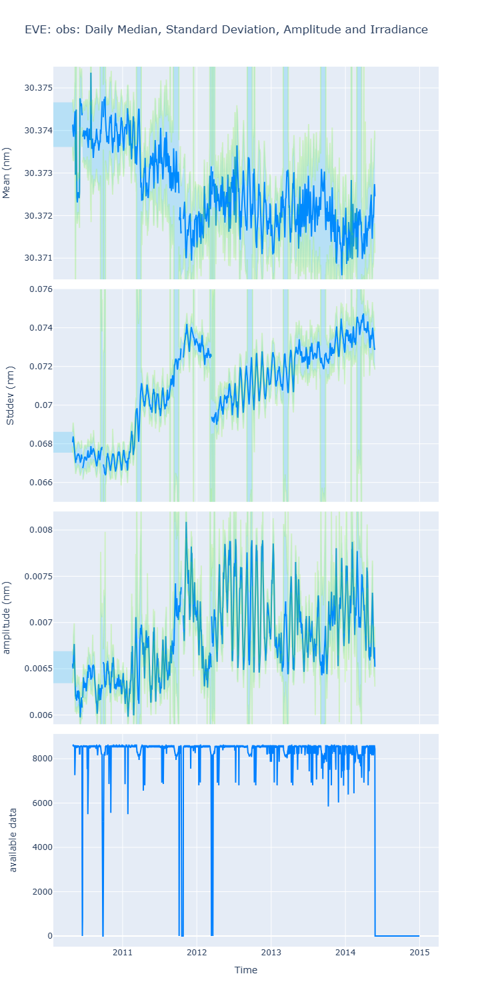

In [23]:
fig = make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=.011)

valid_day=np.where(daily_fit_df['available_data']>=np.nanmean(daily_fit_df['available_data'])*0.2,1,np.nan)
x = daily_fit_df.index
y_median = daily_fit_df['median_of_mean']*valid_day
y_stddev = daily_fit_df['stddev_of_mean']
fill_x = np.concatenate([x, x[::-1]])
fill_y = np.concatenate([y_median + 3 * y_stddev, (y_median - 3 * y_stddev)[::-1]])

# Plot the mean line
fig.add_trace(go.Scatter(x=x, y=y_median,
                              showlegend=False, 
                        line=dict(color='rgb(0,128,255)', )) ,
              row=1, col=1,)
# Plot the shaded area between mean + 3 std deviations and mean - 3 std deviations
fig.add_trace(go.Scatter(x=fill_x, y=fill_y, mode='lines', 
                              fill='tozerox', 
                              fillcolor='rgba(0,176,246,0.2)',
                              line=dict(color='rgba(127,255,0,0.2)'),
                              showlegend=False, 
                              name='3 Std. Dev.'),
             row=1, col=1)

fig.update_yaxes(title_text="Mean (nm)",range=[30.3705, 30.3755],row=1, col=1)
# Show the plot



# Create a figure for fwhm
x = daily_fit_df.index
y_median = daily_fit_df['median_of_fwhm']*valid_day
y_stddev = daily_fit_df['stddev_of_fwhm']
fill_x = np.concatenate([x, x[::-1]])
fill_y = np.concatenate([y_median + 3 * y_stddev, (y_median - 3 * y_stddev)[::-1]])

fig.add_trace(go.Scatter(x=x, y=y_median,
                            showlegend=False,
                         line=dict(color='rgb(0,128,255)'),),
                      row=2, col=1)
# Plot the shaded area between mean + 3 std deviations and mean - 3 std deviations
fig.add_trace(go.Scatter(x=fill_x, y=fill_y, mode='lines', 
                              fill='tozerox', 
                              fillcolor='rgba(0,176,246,0.2)',
                              line=dict(color='rgba(127,255,0,0.2)'),
                              showlegend=False,
                              name='3 Std. Dev.'),
                    row=2, col=1)

fig.update_yaxes(title_text="Stddev (nm)",
                 range=[0.065, 0.076],
                 row=2, col=1)





# # Create a figure for amplitude
x = daily_fit_df.index
y_median = daily_fit_df['median_of_amplitude']*valid_day
y_stddev = daily_fit_df['stddev_of_amplitude']
fill_x = np.concatenate([x, x[::-1]])
fill_y = np.concatenate([y_median + 3 * y_stddev, (y_median - 3 * y_stddev)[::-1]])


fig.add_trace(go.Scatter(x=daily_fit_df.index, y=y_median,
                                         showlegend=False,
                        line=dict(color='rgb(0,128,255)'),),
                         row=3, col=1)
# Plot the shaded area between mean + 3 std deviations and mean - 3 std deviations
fig.add_trace(go.Scatter(x=fill_x, y=fill_y, mode='lines', 
                              fill='tozerox', 
                              fillcolor='rgba(0,176,246,0.2)',
                              line=dict(color='rgba(127,255,0,0.2)'),
                              showlegend=False, 
                              name='3 Std. Dev.'),
                       row=3, col=1)

fig.update_yaxes(title_text='amplitude (nm)',range=[0.0059, 0.0082],row=3, col=1)



# # Create a figure for data available
x = daily_fit_df.index
fig.add_trace(go.Scatter(x=x,y=daily_fit_df['available_data'],
                             showlegend=False,
                        line=dict(color='rgb(0,128,255)')),
             row=4, col=1)
fig.update_layout(width=1200,height=1500,
                      title_text="EVE: obs: Daily Median, Standard Deviation, Amplitude and Irradiance",
                     legend=dict(x=1, y=0.9)) 
fig.update_yaxes(title_text='available data',row=4, col=1)

fig.update_xaxes(title_text="Time",row=4, col=1)
    
fig.show()
fig.write_html('eve_part/years_2d.html')

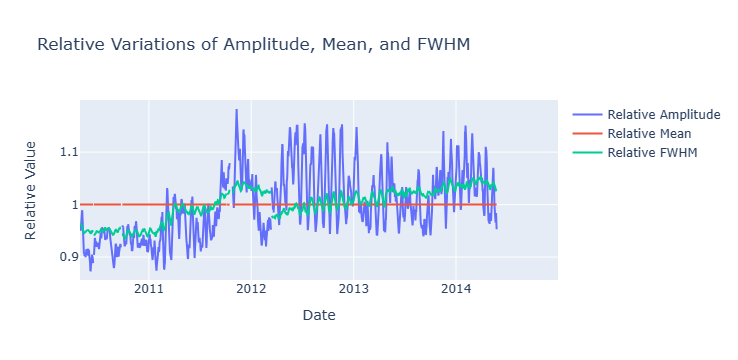

In [21]:
valid_day=np.where(daily_fit_df['available_data']>=np.nanmean(daily_fit_df['available_data'])*0.2,1,np.nan)

# relative variations
ave_amplitude = np.nanmean(daily_fit_df['median_of_amplitude'])
ave_mean = np.nanmean(daily_fit_df['median_of_mean'])
ave_stddev = np.nanmean(daily_fit_df['median_of_fwhm'])

# Calculate the relative variations
relative_amplitude = daily_fit_df['median_of_amplitude']*valid_day / ave_amplitude
relative_mean = daily_fit_df['median_of_mean']*valid_day / ave_mean
relative_stddev = daily_fit_df['median_of_fwhm']*valid_day / ave_stddev

# Create a figure
fig = go.Figure()

# Add traces for relative variations
fig.add_trace(go.Scatter(x=daily_fit_df.index, y=relative_amplitude, name='Relative Amplitude'))
fig.add_trace(go.Scatter(x=daily_fit_df.index, y=relative_mean, name='Relative Mean'))
fig.add_trace(go.Scatter(x=daily_fit_df.index, y=relative_stddev, name='Relative FWHM'))

# Customize the figure layout
fig.update_layout(title="Relative Variations of Amplitude, Mean, and FWHM",
                  xaxis_title="Date",
                  yaxis_title="Relative Value")

# Show the figure
fig.show()
fig.write_html('eve_part/fig/year_relative.html')

In [7]:
def de(x):
    print(np.max(x)-np.min(x))
    return None
de(relative_amplitude)
de(relative_mean)
de(relative_stddev)

0.30875348694233773
0.00015683636927987799
0.11792594357217157


#### 3d daily

In [62]:
a=models.Gaussian1D(amplitude=1E9, mean=30.3783, stddev=0.424)

In [63]:
a(30)

671644853.0065224

In [5]:
wavelength_list_eve

array([30.27, 30.29, 30.31, 30.33, 30.35, 30.37, 30.39, 30.41, 30.43,
       30.45, 30.47, 30.49])

In [ ]:
models.Gaussian1D(amplitude=daily_fit_df.loc[daily_fit_df.index[0],'amplitude'],
                  mean=daily_fit_df.loc[daily_fit_df.index[0],'median'], 
                  stddev=daily_fit_df.loc[daily_fit_df.index[0],'stddev'])

In [64]:
daily_fit_df.index

DatetimeIndex(['2010-04-30', '2010-05-01', '2010-05-02', '2010-05-03',
               '2010-05-04', '2010-05-05', '2010-05-06', '2010-05-07',
               '2010-05-08', '2010-05-09',
               ...
               '2014-12-22', '2014-12-23', '2014-12-24', '2014-12-25',
               '2014-12-26', '2014-12-27', '2014-12-28', '2014-12-29',
               '2014-12-30', '2014-12-31'],
              dtype='datetime64[ns]', name='time', length=1707, freq=None)

In [54]:
start_date = datetime.datetime(2013, 7, 20)
end_date = datetime.datetime(2013, 8, 23)
selected_df = daily_fit_df.loc[start_date:end_date]

In [55]:
selected_df

,median,stddev,amplitude
time,,,
2013-07-20,30.371832,0.031093,0.007007
2013-07-21,30.372009,0.031007,0.007017
2013-07-22,30.371935,0.030919,0.006882
2013-07-23,30.371896,0.030853,0.006840
2013-07-24,30.372046,0.030806,0.006809
2013-07-25,30.372090,0.030733,0.006760
2013-07-26,30.372152,0.030728,0.006697
2013-07-27,30.372324,0.030747,0.006689
2013-07-28,30.372659,0.030772,0.006628


In [81]:
wavelength_list_eve

array([30.27, 30.29, 30.31, 30.33, 30.35, 30.37, 30.39, 30.41, 30.43,
       30.45, 30.47, 30.49])

In [27]:
def get_data(start_date,end_date,daily_fit_df):
    selected_df = daily_fit_df.loc[start_date:end_date]
    irradiance=[]
    selected_time_list=selected_df.index
    for date in selected_time_list:
        func=models.Gaussian1D(amplitude=daily_fit_df.loc[date,'median_of_amplitude'],
                  mean=daily_fit_df.loc[date,'median_of_mean'], 
                  stddev=daily_fit_df.loc[date,'median_of_stddev'])
        irradiance.append(func(wavelength_list_eve))
    return selected_time_list,irradiance

In [28]:
def irradiance_plotly_3d(start_date,end_date,daily_fit_df):
    '''
    3d surface
    time 
    '''
    selected_time_list,irradiance=get_data(start_date,end_date,daily_fit_df)
    
    # Generate x and y coordinates for the surface plot
    x = np.arange(np.shape(irradiance)[1])
    y = np.arange(np.shape(irradiance)[0])
    X, Y = np.meshgrid(x, y)

    # Create the surface plot
    fig = go.Figure(data=[go.Surface(x=X,y=Y,z=irradiance )])
    
    # Customize the layout
    fig.update_layout(
        title='3D Surface Plot',
        # width=550, 
        height=700,
        scene=dict(
            xaxis=dict(
                title='wavelength (nm)',
                ticktext=wavelength_list_eve[::2],  # Set the desired tick labels
                tickvals=x[::2],  # Use the x coordinates as tick values
            ),
            yaxis=dict(title='Time (10s)',
                       ticktext=selected_time_list[::len(selected_time_list)//5],
                      tickvals=y[::len(y)//5]),
            zaxis=dict(title='Irradiance')
        ),
        # margin=dict(l=0,r=20)
    )
    fig.show()
    # fig.write_html('eve_part/plotly_3d.html')

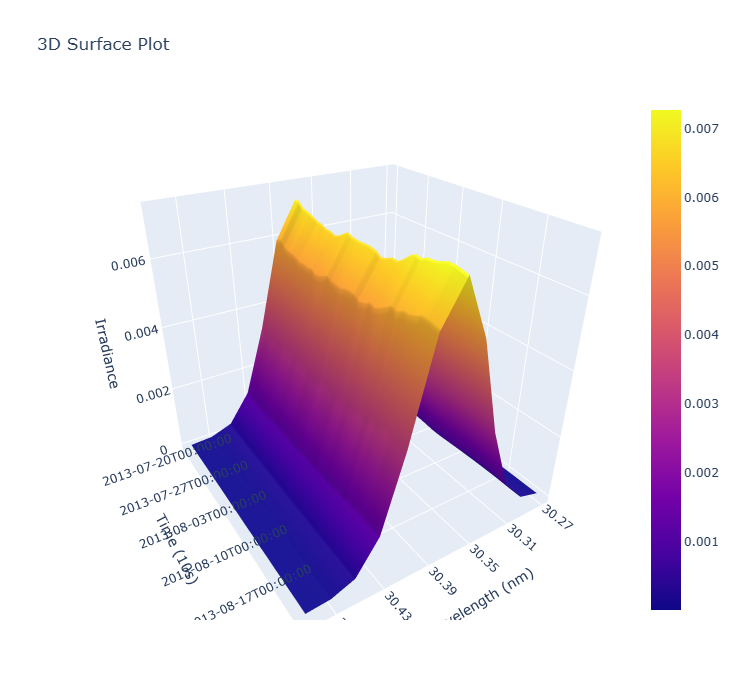

In [29]:
start_date = datetime.datetime(2013, 7, 20)
end_date = datetime.datetime(2013, 8, 23)
# original_df.index
irradiance_plotly_3d(start_date,end_date,daily_fit_df)

In [93]:
get_data(start_time,end_time,daily_fit_df)

(DatetimeIndex(['2010-09-23', '2010-09-24', '2010-09-25', '2010-09-26',
                '2010-09-27', '2010-09-28', '2010-09-29', '2010-09-30',
                '2010-10-01', '2010-10-02',
                ...
                '2014-09-20', '2014-09-21', '2014-09-22', '2014-09-23',
                '2014-09-24', '2014-09-25', '2014-09-26', '2014-09-27',
                '2014-09-28', '2014-09-29'],
               dtype='datetime64[ns]', name='time', length=1468, freq=None),
 [array([8.49738520e-06, 8.33250130e-05, 5.04475312e-04, 1.88572731e-03,
         4.35203425e-03, 6.20126319e-03, 5.45559932e-03, 2.96332451e-03,
         9.93780346e-04, 2.05767148e-04, 2.63048673e-05, 2.07620693e-06]),
  array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]),
  array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]),
  array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]),
  array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]),
  array([7.76295534e-

### matplotlib visual

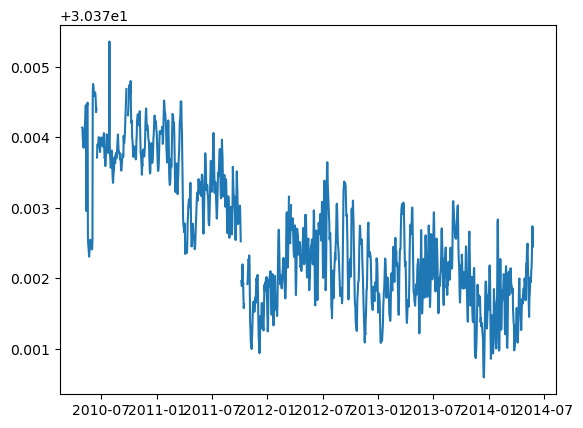

In [30]:
fig,ax=plt.subplots()
ax.plot(daily_fit_df.loc[:,'median_of_mean'])
# ax.plot(fit_10s_df.loc[:,'mean'])
# plt.savefig('eve_part/fig/year_mean.png')
# plt.close(fig)

### save && read

In [13]:
daily_fit_df.head()
# mean
# fwhm
# amplitude

,median_of_mean,median_of_fwhm,median_of_amplitude,stddev_of_mean,stddev_of_fwhm,stddev_of_amplitude,available_data
time,,,,,,,
2010-04-30,30.374138,0.068078,0.006518,0.000175,0.000179,0.000058,8570
2010-05-01,30.374133,0.068256,0.006556,0.000199,0.000164,0.000052,8579
2010-05-02,30.374000,0.068359,0.006503,0.000210,0.000165,0.000048,8579
2010-05-03,30.373922,0.068380,0.006513,0.000206,0.000240,0.000049,8640
2010-05-04,30.373876,0.068305,0.006656,0.000195,0.000216,0.000059,8578


In [7]:
daily_fit_df.to_csv('eve_part/data/daily_data.csv',index_label='time')

In [8]:
daily_fit_df=pd.read_csv ('eve_part/data/daily_data.csv')
daily_fit_df=daily_fit_df.set_index('time')
daily_fit_df.index = pd.to_datetime(daily_fit_df.index)

In [9]:
daily_fit_df.index 

DatetimeIndex(['2010-04-30', '2010-05-01', '2010-05-02', '2010-05-03',
               '2010-05-04', '2010-05-05', '2010-05-06', '2010-05-07',
               '2010-05-08', '2010-05-09',
               ...
               '2014-12-22', '2014-12-23', '2014-12-24', '2014-12-25',
               '2014-12-26', '2014-12-27', '2014-12-28', '2014-12-29',
               '2014-12-30', '2014-12-31'],
              dtype='datetime64[ns]', name='time', length=1707, freq=None)

In [10]:
daily_fit_df.loc[datetime.datetime(2010,6,18)]

median_of_mean          30.373714
median_of_fwhm           0.066787
median_of_amplitude      0.006147
stddev_of_mean           0.000226
stddev_of_fwhm           0.000248
stddev_of_amplitude      0.000050
available_data         825.000000
Name: 2010-06-18 00:00:00, dtype: float64

In [11]:
datetime.datetime(2010,6,11,0,0) in daily_fit_df.index 

True

## FFT

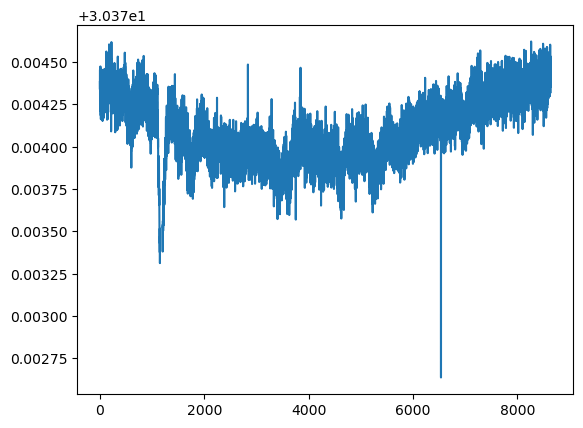

In [ ]:
fig,ax=plt.subplots()
ax.plot(obs_cen_wave[2011011])

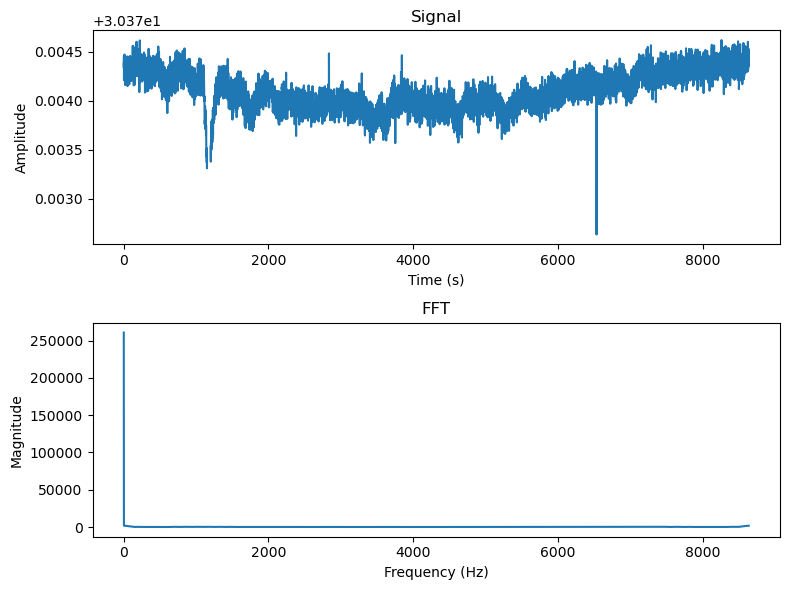

In [ ]:
X = np.fft.fft(np.nan_to_num(obs_cen_wave[11]))

# Compute the frequency axis
freqs = np.fft.fftfreq(8640)

# Plot the results
fig, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot( obs_cen_wave[11])
ax[0].set_xlabel('Time (s)')
ax[0].set_ylabel('Amplitude')
ax[0].set_title('Signal')

ax[1].plot(np.abs(X))
ax[1].set_xlabel('Frequency (Hz)')
ax[1].set_ylabel('Magnitude')
ax[1].set_title('FFT')
# ax[1].set_xlim([-0.001,0.001])

plt.tight_layout()

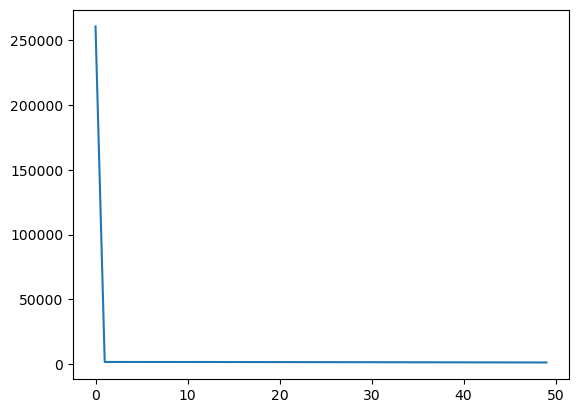

In [56]:
fig, ax = plt.subplots()
ax.plot(np.abs(X)[:50])

In [45]:
np.shape(freqs)

(8640,)

In [48]:
np.shape(X)

(8640,)

In [57]:
X[0]

(260700.92574078086+0j)

In [61]:
X[3]

(1456.2529741675053+932.663183413247j)

In [35]:
8640**-1

0.00011574074074074075

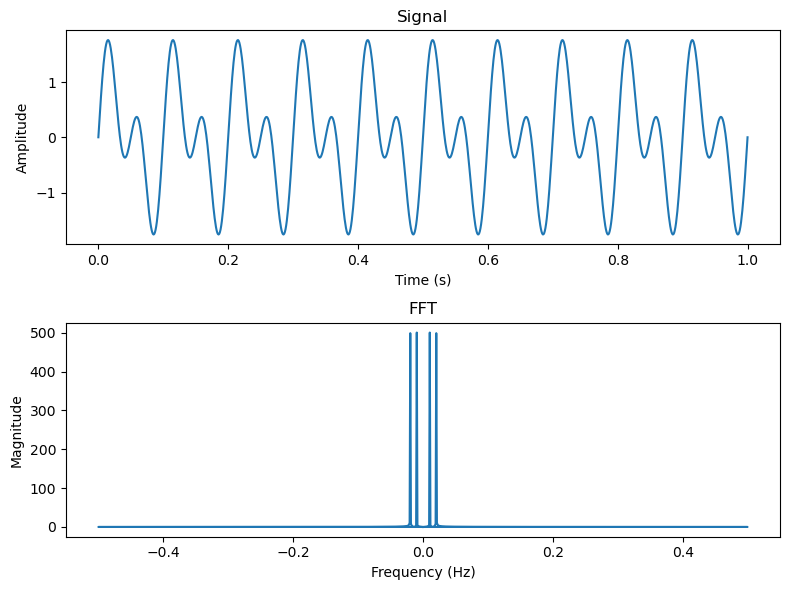

In [37]:
import numpy as np
import matplotlib.pyplot as plt

# Generate the signal
N = 1000
t = np.linspace(0, 1, N)
x = np.sin(2*np.pi*10*t) + np.sin(2*np.pi*20*t)

# Compute the FFT
X = np.fft.fft(x)

# Compute the frequency axis
freqs = np.fft.fftfreq(N)

# Plot the results
fig, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot(t, x)
ax[0].set_xlabel('Time (s)')
ax[0].set_ylabel('Amplitude')
ax[0].set_title('Signal')

ax[1].plot(freqs, np.abs(X))
ax[1].set_xlabel('Frequency (Hz)')
ax[1].set_ylabel('Magnitude')
ax[1].set_title('FFT')

plt.tight_layout()

In [131]:
X

array([ 1.18064595e+07+3.66929598e-10j,  2.19623592e+01-4.43684272e+01j,
       -3.29456588e+00+4.40165906e+01j, ...,
       -1.33050522e+01-1.81253158e+01j, -3.29456588e+00-4.40165906e+01j,
        2.19623592e+01+4.43684272e+01j])

In [25]:
import numpy as np
from scipy.optimize import curve_fit

# Define the function x(t)
def func(t, a, b):
    return a*t + b*np.sin(np.exp(t**3))

# Generate some sample data
t = np.linspace(0, 1, 100)  # Replace with your actual t values
x = func(t, 1.5, 2.5)  # Replace with your actual x values (calculated from the function)

# Fit the coefficients
popt, pcov = curve_fit(func, t, x)

# Extract the fitted coefficients
a_fit, b_fit = popt

# Print the fitted coefficients
print("Fitted coefficients:")
print("a =", a_fit)
print("b =", b_fit)


Fitted coefficients:
a = 1.4999999999999998
b = 2.5


In [26]:
curve_fit?

Signature:
curve_fit(
    f,
    xdata,
    ydata,
    p0=None,
    sigma=None,
    absolute_sigma=False,
    check_finite=True,
    bounds=(-inf, inf),
    method=None,
    jac=None,
    *,
    full_output=False,
    **kwargs,
)
Docstring:
Use non-linear least squares to fit a function, f, to data.

Assumes ``ydata = f(xdata, *params) + eps``.

Parameters
----------
f : callable
    The model function, f(x, ...). It must take the independent
    variable as the first argument and the parameters to fit as
    separate remaining arguments.
xdata : array_like
    The independent variable where the data is measured.
    Should usually be an M-length sequence or an (k,M)-shaped array for
    functions with k predictors, and each element should be float
    convertible if it is an array like object.
ydata : array_like
    The dependent data, a length M array - nominally ``f(xdata, ...)``.
p0 : array_like, optional
    Initial guess for the parameters (length N). If None, then the
    initia

In [3]:
# give me a 2D numpy array
a=np.array([[1,2,3],
            [1.1,2,3],
            [1,1,2]])

In [6]:
a[0]=np.nan

In [7]:
a

array([[nan, nan, nan],
       [1.1, 2. , 3. ],
       [1. , 1. , 2. ]])

In [12]:
a=np.array([[1,2,3],
            [1.1,2,3],
            [1,1,2]])

for i in range(a.shape[1]):
    if np.max(a[i])<3:
        a[i]=np.nan
a

array([[1. , 2. , 3. ],
       [1.1, 2. , 3. ],
       [nan, nan, nan]])

3